In [1]:
import e_utils
import e_networks
import e_ensemble
from grad_cam import GradCAM
from e_plot_utils import plot_confmat, plot_gradcam

import torch
import torchvision
import torchvision.datasets as datasets
from torch.utils.data import DataLoader

In [2]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [3]:
torch.cuda.is_available()

True

In [4]:
torch.cuda.current_device()

0

In [5]:
train_set = datasets.ImageFolder(root=e_utils.dirs['train'], transform=e_utils.transform['eval'])
test_set = datasets.ImageFolder(root=e_utils.dirs['test'], transform=e_utils.transform['eval'])
train_dl = DataLoader(train_set, batch_size=20)
test_dl = DataLoader(test_set, batch_size=10)

### VGG-16

In [7]:
vgg16 = e_networks.get_vgg16(out_features=4, path='models/lr3e-5_vgg_cuda.pth')
train_preds = e_utils.get_all_preds(vgg16, train_dl)
test_preds = e_utils.get_all_preds(vgg16, test_dl)

train_preds.shape, test_preds.shape

/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


(torch.Size([20717, 4]), torch.Size([250, 4]))

In [8]:
train_correct = e_utils.get_num_correct(train_preds, torch.as_tensor(train_set.targets, device=device))
test_correct = e_utils.get_num_correct(test_preds, torch.as_tensor(test_set.targets, device=device))

print(f'Train Correct: {train_correct:5}\tTrain Accuracy: {(100*train_correct/len(train_set)):5.2f}%')
print(f'Test Correct: {test_correct:6}\tTest Accuracy: {(100*test_correct/len(test_set)):6.2f}%')

Train Correct: 20611	Train Accuracy: 99.49%
Test Correct:    238	Test Accuracy:  95.20%


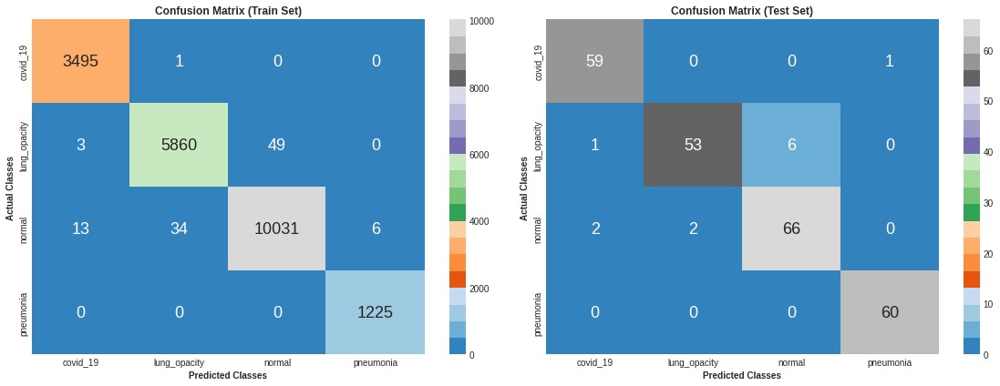

In [9]:
train_confmat = e_utils.get_confmat(train_set.targets, train_preds)
test_confmat = e_utils.get_confmat(test_set.targets, test_preds)
plot_confmat(train_confmat, test_confmat, train_set.classes, f'{type(vgg16).__name__.lower()}')

In [10]:
results = e_utils.get_results(test_confmat, test_set.classes)
results

{'covid_19': [0.9834710743801653,
  0.9516129032258065,
  0.9833333333333333,
  0.9672131147540983],
 'lung_opacity': [0.9635627530364372,
  0.9636363636363636,
  0.8833333333333333,
  0.9217391304347826],
 'normal': [0.9596774193548387,
  0.9166666666666666,
  0.9428571428571428,
  0.9295774647887323],
 'pneumonia': [0.99581589958159, 0.9836065573770492, 1.0, 0.9917355371900827]}

### AlexNet

In [6]:
alexnet= e_networks.get_alexnet(out_features=4, path='models/lr3e-5_alexnet_cuda.pth')
train_preds = e_utils.get_all_preds(alexnet, train_dl)
test_preds = e_utils.get_all_preds(alexnet, test_dl)

train_preds.shape, test_preds.shape

C:\Users\Abhijith\anaconda3\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\Abhijith\anaconda3\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


(torch.Size([46930, 1000]), torch.Size([3028, 1000]))

In [7]:
train_correct = e_utils.get_num_correct(train_preds, torch.as_tensor(train_set.targets, device=device))
test_correct = e_utils.get_num_correct(test_preds, torch.as_tensor(test_set.targets, device=device))

print(f'Train Correct: {train_correct:5}\tTrain Accuracy: {(100*train_correct/len(train_set)):5.2f}%')
print(f'Test Correct: {test_correct:6}\tTest Accuracy: {(100*test_correct/len(test_set)):6.2f}%')

Train Correct: 45376	Train Accuracy: 96.69%
Test Correct:   2867	Test Accuracy:  94.68%


tensor([[1, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0]], dtype=torch.int16)_0_0
tensor([[2, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0]], dtype=torch.int16)_0_0
tensor([[3, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0]], dtype=torch.int16)_0_0
tensor([[4, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0]], dtype=torch.int16)_0_0
tensor([[5, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0]], dtype=torch.int16)_0_0
tensor([[6, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0]], dtype=torch.int16)_0_0
tensor([[7, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0]], dtype=torch.int16)_0_0
tensor([[8, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0]], dtype=torch.int16)_0_0
tensor([[9, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0]], dtype=torch.int

tensor([[1260,    1,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[1261,    1,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[1262,    1,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[1263,    1,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[1264,    1,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[1265,    1,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[1266,    1,    0,    0],
      

tensor([[2278,    1,    1,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[2279,    1,    1,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[2280,    1,    1,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[2281,    1,    1,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[2282,    1,    1,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[2283,    1,    1,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[2284,    1,    1,    0],
      

tensor([[3381,    1,    1,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[3382,    1,    1,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[3383,    1,    1,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[3384,    1,    1,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[3385,    1,    1,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[3386,    1,    1,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[3387,    1,    1,    0],
      

tensor([[4338,    1,    3,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[4339,    1,    3,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[4340,    1,    3,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[4341,    1,    3,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[4342,    1,    3,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[4343,    1,    3,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[4344,    1,    3,    0],
      

tensor([[5452,    1,    5,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[5453,    1,    5,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[5454,    1,    5,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[5455,    1,    5,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[5456,    1,    5,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[5457,    1,    5,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[5458,    1,    5,    0],
      

tensor([[6374,    1,    5,    0],
        [   2,  251,    3,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   2,  252,    3,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   2,  253,    3,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   2,  254,    3,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   2,  255,    3,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   2,  256,    3,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
      

tensor([[6374,    1,    5,    0],
        [   2, 1286,   40,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   2, 1287,   40,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   2, 1288,   40,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   2, 1289,   40,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   2, 1290,   40,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   2, 1291,   40,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
      

tensor([[6374,    1,    5,    0],
        [   3, 2300,   70,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   3, 2301,   70,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   3, 2302,   70,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   3, 2303,   70,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   3, 2304,   70,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   3, 2305,   70,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
      

tensor([[6374,    1,    5,    0],
        [   6, 3404,  117,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   6, 3405,  117,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   6, 3406,  117,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   6, 3407,  117,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   6, 3408,  117,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   6, 3409,  117,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
      

tensor([[6374,    1,    5,    0],
        [   6, 4499,  157,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   6, 4500,  157,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   6, 4501,  157,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   6, 4502,  157,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   6, 4503,  157,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   6, 4504,  157,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
      

tensor([[6374,    1,    5,    0],
        [   7, 5610,  187,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   7, 5611,  187,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   7, 5612,  187,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   7, 5613,  187,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   7, 5614,  187,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   7, 5615,  187,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
      

tensor([[6374,    1,    5,    0],
        [   8, 6654,  211,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   8, 6655,  211,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   8, 6656,  211,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   8, 6657,  211,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   8, 6658,  211,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [   8, 6659,  211,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
      

tensor([[6374,    1,    5,    0],
        [  10, 7702,  242,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [  10, 7703,  242,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [  10, 7704,  242,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [  10, 7705,  242,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [  10, 7706,  242,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [  10, 7707,  242,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
      

tensor([[6374,    1,    5,    0],
        [  13, 8762,  268,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [  13, 8763,  268,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [  13, 8764,  268,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [  13, 8765,  268,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [  13, 8766,  268,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [  13, 8767,  268,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
      

tensor([[6374,    1,    5,    0],
        [  16, 9826,  300,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [  16, 9827,  300,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [  16, 9828,  300,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [  16, 9829,  300,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [  16, 9830,  300,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
        [  16, 9831,  300,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6374,    1,    5,    0],
      

tensor([[ 6374,     1,     5,     0],
        [   19, 10830,   357,     0],
        [    0,     0,     0,     0],
        [    0,     0,     0,     0]], dtype=torch.int16)_1_1
tensor([[ 6374,     1,     5,     0],
        [   19, 10831,   357,     0],
        [    0,     0,     0,     0],
        [    0,     0,     0,     0]], dtype=torch.int16)_1_1
tensor([[ 6374,     1,     5,     0],
        [   19, 10832,   357,     0],
        [    0,     0,     0,     0],
        [    0,     0,     0,     0]], dtype=torch.int16)_1_1
tensor([[ 6374,     1,     5,     0],
        [   19, 10833,   357,     0],
        [    0,     0,     0,     0],
        [    0,     0,     0,     0]], dtype=torch.int16)_1_1
tensor([[ 6374,     1,     5,     0],
        [   19, 10834,   357,     0],
        [    0,     0,     0,     0],
        [    0,     0,     0,     0]], dtype=torch.int16)_1_1
tensor([[ 6374,     1,     5,     0],
        [   19, 10835,   357,     0],
        [    0,     0,     0,     0],
      

tensor([[ 6374,     1,     5,     0],
        [   21, 11829,   442,     0],
        [    0,     0,     0,     0],
        [    0,     0,     0,     0]], dtype=torch.int16)_1_2
tensor([[ 6374,     1,     5,     0],
        [   21, 11830,   442,     0],
        [    0,     0,     0,     0],
        [    0,     0,     0,     0]], dtype=torch.int16)_1_1
tensor([[ 6374,     1,     5,     0],
        [   21, 11831,   442,     0],
        [    0,     0,     0,     0],
        [    0,     0,     0,     0]], dtype=torch.int16)_1_1
tensor([[ 6374,     1,     5,     0],
        [   21, 11832,   442,     0],
        [    0,     0,     0,     0],
        [    0,     0,     0,     0]], dtype=torch.int16)_1_1
tensor([[ 6374,     1,     5,     0],
        [   21, 11833,   442,     0],
        [    0,     0,     0,     0],
        [    0,     0,     0,     0]], dtype=torch.int16)_1_1
tensor([[ 6374,     1,     5,     0],
        [   21, 11834,   442,     0],
        [    0,     0,     0,     0],
      

tensor([[ 6374,     1,     5,     0],
        [   27, 12825,   506,     0],
        [    0,     0,     0,     0],
        [    0,     0,     0,     0]], dtype=torch.int16)_1_1
tensor([[ 6374,     1,     5,     0],
        [   27, 12826,   506,     0],
        [    0,     0,     0,     0],
        [    0,     0,     0,     0]], dtype=torch.int16)_1_1
tensor([[ 6374,     1,     5,     0],
        [   27, 12827,   506,     0],
        [    0,     0,     0,     0],
        [    0,     0,     0,     0]], dtype=torch.int16)_1_1
tensor([[ 6374,     1,     5,     0],
        [   27, 12828,   506,     0],
        [    0,     0,     0,     0],
        [    0,     0,     0,     0]], dtype=torch.int16)_1_1
tensor([[ 6374,     1,     5,     0],
        [   27, 12828,   507,     0],
        [    0,     0,     0,     0],
        [    0,     0,     0,     0]], dtype=torch.int16)_1_2
tensor([[ 6374,     1,     5,     0],
        [   27, 12829,   507,     0],
        [    0,     0,     0,     0],
      

tensor([[ 6374,     1,     5,     0],
        [   30, 13755,   579,     0],
        [    0,     0,     0,     0],
        [    0,     0,     0,     0]], dtype=torch.int16)_1_1
tensor([[ 6374,     1,     5,     0],
        [   30, 13756,   579,     0],
        [    0,     0,     0,     0],
        [    0,     0,     0,     0]], dtype=torch.int16)_1_1
tensor([[ 6374,     1,     5,     0],
        [   30, 13757,   579,     0],
        [    0,     0,     0,     0],
        [    0,     0,     0,     0]], dtype=torch.int16)_1_1
tensor([[ 6374,     1,     5,     0],
        [   30, 13757,   580,     0],
        [    0,     0,     0,     0],
        [    0,     0,     0,     0]], dtype=torch.int16)_1_2
tensor([[ 6374,     1,     5,     0],
        [   30, 13758,   580,     0],
        [    0,     0,     0,     0],
        [    0,     0,     0,     0]], dtype=torch.int16)_1_1
tensor([[ 6374,     1,     5,     0],
        [   30, 13759,   580,     0],
        [    0,     0,     0,     0],
      

tensor([[ 6374,     1,     5,     0],
        [   33, 14689,   641,     0],
        [    0,     0,     0,     0],
        [    0,     0,     0,     0]], dtype=torch.int16)_1_1
tensor([[ 6374,     1,     5,     0],
        [   33, 14690,   641,     0],
        [    0,     0,     0,     0],
        [    0,     0,     0,     0]], dtype=torch.int16)_1_1
tensor([[ 6374,     1,     5,     0],
        [   33, 14691,   641,     0],
        [    0,     0,     0,     0],
        [    0,     0,     0,     0]], dtype=torch.int16)_1_1
tensor([[ 6374,     1,     5,     0],
        [   33, 14692,   641,     0],
        [    0,     0,     0,     0],
        [    0,     0,     0,     0]], dtype=torch.int16)_1_1
tensor([[ 6374,     1,     5,     0],
        [   33, 14693,   641,     0],
        [    0,     0,     0,     0],
        [    0,     0,     0,     0]], dtype=torch.int16)_1_1
tensor([[ 6374,     1,     5,     0],
        [   33, 14694,   641,     0],
        [    0,     0,     0,     0],
      

tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    0,     0,   466,     7],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    0,     0,   467,     7],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    0,     0,   468,     7],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    1,     0,   468,     7],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    1,     0,   469,     7],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    1,     0,   470,     7],
      

tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    1,    29,  1402,     8],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    1,    29,  1403,     8],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    1,    29,  1404,     8],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    1,    29,  1405,     8],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    1,    29,  1406,     8],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    1,    29,  1407,     8],
      

tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    4,    71,  2464,     8],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    4,    71,  2465,     8],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    4,    71,  2466,     8],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    4,    71,  2467,     8],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    4,    71,  2468,     8],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    4,    71,  2469,     8],
      

tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    6,    96,  3473,     8],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    6,    96,  3474,     8],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    6,    96,  3475,     8],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    6,    96,  3476,     8],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    6,    96,  3477,     8],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    6,    96,  3478,     8],
      

tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    7,   149,  4409,     8],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    7,   149,  4410,     8],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    7,   149,  4411,     8],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    7,   149,  4412,     8],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    7,   149,  4413,     8],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    7,   149,  4414,     8],
      

tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    7,   180,  5391,    10],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    7,   180,  5392,    10],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    7,   180,  5393,    10],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    7,   180,  5394,    10],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    7,   180,  5395,    10],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    7,   180,  5396,    10],
      

tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    8,   206,  6335,    10],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    8,   206,  6336,    10],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    8,   206,  6337,    10],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    8,   206,  6338,    10],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    8,   206,  6339,    10],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    8,   206,  6340,    10],
      

tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    9,   254,  7324,    11],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    9,   254,  7325,    11],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    9,   254,  7326,    11],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    9,   254,  7327,    11],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    9,   254,  7328,    11],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [    9,   254,  7329,    11],
      

tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   14,   297,  8310,    12],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   14,   297,  8311,    12],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   14,   297,  8312,    12],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   14,   297,  8313,    12],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   14,   297,  8314,    12],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   14,   297,  8315,    12],
      

tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   14,   347,  9238,    17],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   14,   347,  9239,    17],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   14,   347,  9240,    17],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   14,   347,  9241,    17],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   14,   347,  9242,    17],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   14,   347,  9243,    17],
      

tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   16,   386, 10267,    18],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   16,   386, 10268,    18],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   16,   386, 10269,    18],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   16,   386, 10270,    18],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   16,   387, 10270,    18],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_1
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   16,   387, 10271,    18],
      

tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   16,   421, 11220,    19],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   16,   421, 11221,    19],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   16,   421, 11222,    19],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   16,   421, 11223,    19],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   16,   421, 11224,    19],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   16,   421, 11225,    19],
      

tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   18,   463, 12169,    25],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   18,   463, 12170,    25],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   18,   463, 12171,    25],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   18,   463, 12172,    25],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   18,   463, 12173,    25],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   18,   463, 12174,    25],
      

tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   19,   503, 13199,    29],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   19,   503, 13200,    29],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   19,   503, 13201,    29],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   19,   503, 13202,    29],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   19,   503, 13203,    29],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   19,   503, 13204,    29],
      

tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   22,   547, 14303,    32],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   22,   547, 14304,    32],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   22,   547, 14305,    32],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   22,   547, 14306,    32],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   22,   547, 14307,    32],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   22,   547, 14308,    32],
      

tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   23,   585, 15343,    33],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   23,   586, 15343,    33],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_1
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   23,   586, 15344,    33],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   23,   586, 15345,    33],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   23,   586, 15346,    33],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   23,   586, 15347,    33],
      

tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   24,   626, 16353,    35],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   24,   626, 16354,    35],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   24,   626, 16355,    35],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   24,   626, 16356,    35],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   24,   626, 16357,    35],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   24,   626, 16358,    35],
      

tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   24,   656, 17388,    36],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   24,   656, 17389,    36],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   24,   656, 17390,    36],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   24,   656, 17391,    36],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   24,   656, 17392,    36],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   24,   656, 17393,    36],
      

tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   25,   697, 18395,    42],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   25,   697, 18396,    42],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   25,   697, 18397,    42],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   25,   697, 18398,    42],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   25,   697, 18399,    42],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   25,   697, 18400,    42],
      

tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   31,   727, 19387,    43],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   31,   728, 19387,    43],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_1
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   31,   728, 19388,    43],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   31,   728, 19389,    43],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   31,   728, 19390,    43],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   31,   728, 19391,    43],
      

tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   33,   750, 20367,    48],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_3
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   33,   750, 20368,    48],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   33,   750, 20369,    48],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   33,   750, 20370,    48],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   33,   750, 20371,    48],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   33,   750, 20372,    48],
      

tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   33,   762, 20741,    52],
        [    0,     0,     0,   600]], dtype=torch.int16)_3_3
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   33,   762, 20741,    52],
        [    0,     0,     0,   601]], dtype=torch.int16)_3_3
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   33,   762, 20741,    52],
        [    0,     0,     0,   602]], dtype=torch.int16)_3_3
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   33,   762, 20741,    52],
        [    0,     0,     0,   603]], dtype=torch.int16)_3_3
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   33,   762, 20741,    52],
        [    0,     0,     0,   604]], dtype=torch.int16)_3_3
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   33,   762, 20741,    52],
      

tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   33,   762, 20741,    52],
        [    0,     0,     0,  1505]], dtype=torch.int16)_3_3
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   33,   762, 20741,    52],
        [    0,     0,     0,  1506]], dtype=torch.int16)_3_3
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   33,   762, 20741,    52],
        [    0,     0,     0,  1507]], dtype=torch.int16)_3_3
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   33,   762, 20741,    52],
        [    0,     0,     0,  1508]], dtype=torch.int16)_3_3
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   33,   762, 20741,    52],
        [    0,     0,     0,  1509]], dtype=torch.int16)_3_3
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   33,   762, 20741,    52],
      

tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   33,   762, 20741,    52],
        [    0,     0,     0,  2469]], dtype=torch.int16)_3_3
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   33,   762, 20741,    52],
        [    0,     0,     0,  2470]], dtype=torch.int16)_3_3
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   33,   762, 20741,    52],
        [    0,     0,     0,  2471]], dtype=torch.int16)_3_3
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   33,   762, 20741,    52],
        [    0,     0,     0,  2472]], dtype=torch.int16)_3_3
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   33,   762, 20741,    52],
        [    0,     0,     0,  2473]], dtype=torch.int16)_3_3
tensor([[ 6374,     1,     5,     0],
        [   35, 15077,   664,     0],
        [   33,   762, 20741,    52],
      

tensor([[295,   2,   3,   0],
        [  0,   0,   0,   0],
        [  0,   0,   0,   0],
        [  0,   0,   0,   0]], dtype=torch.int16)_0_0
tensor([[296,   2,   3,   0],
        [  0,   0,   0,   0],
        [  0,   0,   0,   0],
        [  0,   0,   0,   0]], dtype=torch.int16)_0_0
tensor([[297,   2,   3,   0],
        [  0,   0,   0,   0],
        [  0,   0,   0,   0],
        [  0,   0,   0,   0]], dtype=torch.int16)_0_0
tensor([[298,   2,   3,   0],
        [  0,   0,   0,   0],
        [  0,   0,   0,   0],
        [  0,   0,   0,   0]], dtype=torch.int16)_0_0
tensor([[299,   2,   3,   0],
        [  0,   0,   0,   0],
        [  0,   0,   0,   0],
        [  0,   0,   0,   0]], dtype=torch.int16)_0_0
tensor([[300,   2,   3,   0],
        [  0,   0,   0,   0],
        [  0,   0,   0,   0],
        [  0,   0,   0,   0]], dtype=torch.int16)_0_0
tensor([[301,   2,   3,   0],
        [  0,   0,   0,   0],
        [  0,   0,   0,   0],
        [  0,   0,   0,   0]], dtype=torch.int

tensor([[569,  10,   7,   0],
        [  3, 755,  44,   0],
        [  0,   0,   0,   0],
        [  0,   0,   0,   0]], dtype=torch.int16)_1_1
tensor([[569,  10,   7,   0],
        [  3, 756,  44,   0],
        [  0,   0,   0,   0],
        [  0,   0,   0,   0]], dtype=torch.int16)_1_1
tensor([[569,  10,   7,   0],
        [  3, 757,  44,   0],
        [  0,   0,   0,   0],
        [  0,   0,   0,   0]], dtype=torch.int16)_1_1
tensor([[569,  10,   7,   0],
        [  3, 758,  44,   0],
        [  0,   0,   0,   0],
        [  0,   0,   0,   0]], dtype=torch.int16)_1_1
tensor([[569,  10,   7,   0],
        [  3, 759,  44,   0],
        [  0,   0,   0,   0],
        [  0,   0,   0,   0]], dtype=torch.int16)_1_1
tensor([[569,  10,   7,   0],
        [  3, 760,  44,   0],
        [  0,   0,   0,   0],
        [  0,   0,   0,   0]], dtype=torch.int16)_1_1
tensor([[569,  10,   7,   0],
        [  3, 760,  45,   0],
        [  0,   0,   0,   0],
        [  0,   0,   0,   0]], dtype=torch.int

tensor([[569,  10,   7,   0],
        [  3, 841,  52,   0],
        [  3,  57, 875,   1],
        [  0,   0,   0,   0]], dtype=torch.int16)_2_2
tensor([[569,  10,   7,   0],
        [  3, 841,  52,   0],
        [  3,  57, 876,   1],
        [  0,   0,   0,   0]], dtype=torch.int16)_2_2
tensor([[569,  10,   7,   0],
        [  3, 841,  52,   0],
        [  3,  57, 877,   1],
        [  0,   0,   0,   0]], dtype=torch.int16)_2_2
tensor([[569,  10,   7,   0],
        [  3, 841,  52,   0],
        [  3,  57, 878,   1],
        [  0,   0,   0,   0]], dtype=torch.int16)_2_2
tensor([[569,  10,   7,   0],
        [  3, 841,  52,   0],
        [  3,  57, 879,   1],
        [  0,   0,   0,   0]], dtype=torch.int16)_2_2
tensor([[569,  10,   7,   0],
        [  3, 841,  52,   0],
        [  3,  57, 880,   1],
        [  0,   0,   0,   0]], dtype=torch.int16)_2_2
tensor([[569,  10,   7,   0],
        [  3, 841,  52,   0],
        [  3,  57, 881,   1],
        [  0,   0,   0,   0]], dtype=torch.int

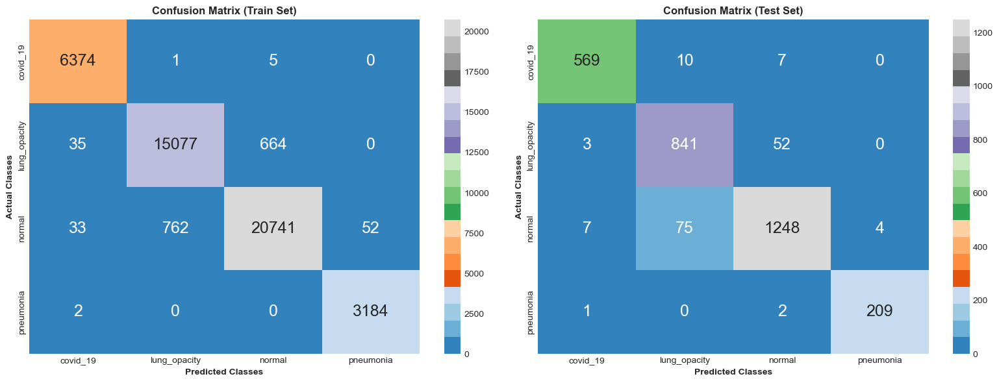

In [8]:
train_confmat = e_utils.get_confmat(train_set.targets, train_preds)
test_confmat = e_utils.get_confmat(test_set.targets, test_preds)
plot_confmat(train_confmat, test_confmat, train_set.classes, f'{type(alexnet).__name__.lower()}')

In [9]:
results = e_utils.get_results(test_confmat, test_set.classes)
results

{'covid_19': ['accuracy : 0.9903281519861831',
  'recall : 0.9810344827586207',
  'precision : 0.9709897610921502',
  'f1score : 0.9759862778730704'],
 'lung_opacity': ['accuracy : 0.9534419687396076',
  'recall : 0.908207343412527',
  'precision : 0.9386160714285714',
  'f1score : 0.9231613611416025'],
 'normal': ['accuracy : 0.9512276045122761',
  'recall : 0.9533995416348358',
  'precision : 0.9355322338830585',
  'f1score : 0.9443813847900113'],
 'pneumonia': ['accuracy : 0.9975643702157272',
  'recall : 0.9812206572769953',
  'precision : 0.9858490566037735',
  'f1score : 0.9835294117647059']}

### Inception_Net V3

In [6]:
inception_v3 = e_networks.get_inception_v3(out_features=4, path='models/lr3e-5_inception3_cuda.pth')
train_preds = e_utils.get_all_preds(inception_v3, train_dl)
test_preds = e_utils.get_all_preds(inception_v3, test_dl)

train_preds.shape, test_preds.shape

C:\Users\Abhijith\anaconda3\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\Abhijith\anaconda3\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)
C:\Users\Abhijith\anaconda3\lib\site-packages\torchvision\models\inception.py:43: FutureWarning: The default weight initialization of inception_v3 will be changed in future releases of torchvision. If you wish to keep the old behavior (which leads to long initialization times due to scipy/scipy#11299), please set init_weights=True.
  warnings.warn(


(torch.Size([46930, 4]), torch.Size([3028, 4]))

In [7]:
train_correct = e_utils.get_num_correct(train_preds, torch.as_tensor(train_set.targets, device=device))
test_correct = e_utils.get_num_correct(test_preds, torch.as_tensor(test_set.targets, device=device))

print(f'Train Correct: {train_correct:5}\tTrain Accuracy: {(100*train_correct/len(train_set)):5.2f}%')
print(f'Test Correct: {test_correct:6}\tTest Accuracy: {(100*test_correct/len(test_set)):6.2f}%')

Train Correct:  7101	Train Accuracy: 15.13%
Test Correct:    570	Test Accuracy:  18.82%


tensor([[1, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0]], dtype=torch.int16)_0_0
tensor([[2, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0]], dtype=torch.int16)_0_0
tensor([[3, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0]], dtype=torch.int16)_0_0
tensor([[4, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0]], dtype=torch.int16)_0_0
tensor([[5, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0]], dtype=torch.int16)_0_0
tensor([[6, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0]], dtype=torch.int16)_0_0
tensor([[7, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0]], dtype=torch.int16)_0_0
tensor([[8, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0]], dtype=torch.int16)_0_0
tensor([[9, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0]], dtype=torch.int

tensor([[1135,   50,   23,   34],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[1136,   50,   23,   34],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[1137,   50,   23,   34],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[1138,   50,   23,   34],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[1139,   50,   23,   34],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[1140,   50,   23,   34],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[1141,   50,   23,   34],
      

tensor([[2100,   53,   44,   51],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[2101,   53,   44,   51],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[2102,   53,   44,   51],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[2103,   53,   44,   51],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[2104,   53,   44,   51],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[2105,   53,   44,   51],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[2106,   53,   44,   51],
      

tensor([[2885,   76,   61,   59],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[2886,   76,   61,   59],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[2887,   76,   61,   59],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[2887,   76,   62,   59],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_2
tensor([[2888,   76,   62,   59],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[2889,   76,   62,   59],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[2890,   76,   62,   59],
      

tensor([[3830,  102,   80,   64],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[3830,  103,   80,   64],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_1
tensor([[3831,  103,   80,   64],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[3832,  103,   80,   64],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[3833,  103,   80,   64],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[3834,  103,   80,   64],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[3835,  103,   80,   64],
      

tensor([[4828,  146,  107,   65],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[4829,  146,  107,   65],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[4830,  146,  107,   65],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[4831,  146,  107,   65],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[4831,  147,  107,   65],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_1
tensor([[4832,  147,  107,   65],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[4833,  147,  107,   65],
      

tensor([[5788,  189,  140,   69],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[5789,  189,  140,   69],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[5790,  189,  140,   69],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[5791,  189,  140,   69],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[5791,  190,  140,   69],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_1
tensor([[5792,  190,  140,   69],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[5793,  190,  140,   69],
      

tensor([[5961,  206,  144,   69],
        [ 494,  321,   31,   29],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[5961,  206,  144,   69],
        [ 495,  321,   31,   29],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [ 495,  322,   31,   29],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[5961,  206,  144,   69],
        [ 495,  323,   31,   29],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[5961,  206,  144,   69],
        [ 496,  323,   31,   29],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [ 496,  324,   31,   29],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[5961,  206,  144,   69],
      

tensor([[5961,  206,  144,   69],
        [1110,  685,   68,   63],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [1110,  686,   68,   63],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[5961,  206,  144,   69],
        [1110,  687,   68,   63],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[5961,  206,  144,   69],
        [1110,  688,   68,   63],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[5961,  206,  144,   69],
        [1111,  688,   68,   63],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [1112,  688,   68,   63],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
      

tensor([[5961,  206,  144,   69],
        [1668, 1099,  112,  103],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[5961,  206,  144,   69],
        [1669, 1099,  112,  103],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [1670, 1099,  112,  103],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [1670, 1100,  112,  103],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[5961,  206,  144,   69],
        [1671, 1100,  112,  103],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [1671, 1100,  112,  104],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_3
tensor([[5961,  206,  144,   69],
      

tensor([[5961,  206,  144,   69],
        [2329, 1486,  173,  145],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[5961,  206,  144,   69],
        [2330, 1486,  173,  145],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [2331, 1486,  173,  145],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [2332, 1486,  173,  145],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [2333, 1486,  173,  145],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [2334, 1486,  173,  145],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
      

tensor([[5961,  206,  144,   69],
        [2892, 1892,  212,  188],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[5961,  206,  144,   69],
        [2893, 1892,  212,  188],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [2894, 1892,  212,  188],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [2895, 1892,  212,  188],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [2896, 1892,  212,  188],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [2897, 1892,  212,  188],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
      

tensor([[5961,  206,  144,   69],
        [3777, 2095,  259,  221],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [3778, 2095,  259,  221],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [3779, 2095,  259,  221],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [3780, 2095,  259,  221],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [3781, 2095,  259,  221],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [3782, 2095,  259,  221],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
      

tensor([[5961,  206,  144,   69],
        [4635, 2239,  301,  265],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [4635, 2240,  301,  265],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[5961,  206,  144,   69],
        [4636, 2240,  301,  265],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [4637, 2240,  301,  265],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [4638, 2240,  301,  265],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [4639, 2240,  301,  265],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
      

tensor([[5961,  206,  144,   69],
        [5442, 2376,  333,  292],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [5443, 2376,  333,  292],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [5444, 2376,  333,  292],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [5445, 2376,  333,  292],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [5446, 2376,  333,  292],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [5447, 2376,  333,  292],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
      

tensor([[5961,  206,  144,   69],
        [6225, 2526,  354,  322],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [6226, 2526,  354,  322],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [6226, 2526,  354,  323],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_3
tensor([[5961,  206,  144,   69],
        [6227, 2526,  354,  323],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [6227, 2527,  354,  323],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[5961,  206,  144,   69],
        [6228, 2527,  354,  323],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
      

tensor([[5961,  206,  144,   69],
        [7143, 2680,  399,  357],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [7144, 2680,  399,  357],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [7145, 2680,  399,  357],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [7146, 2680,  399,  357],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [7147, 2680,  399,  357],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [7148, 2680,  399,  357],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
      

tensor([[5961,  206,  144,   69],
        [7984, 2842,  438,  392],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[5961,  206,  144,   69],
        [7985, 2842,  438,  392],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [7986, 2842,  438,  392],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [7987, 2842,  438,  392],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [7988, 2842,  438,  392],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [7989, 2842,  438,  392],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
      

tensor([[5961,  206,  144,   69],
        [8784, 2990,  492,  422],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [8785, 2990,  492,  422],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [8786, 2990,  492,  422],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [8786, 2990,  492,  423],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_3
tensor([[5961,  206,  144,   69],
        [8787, 2990,  492,  423],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [8788, 2990,  492,  423],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
      

tensor([[5961,  206,  144,   69],
        [9629, 3166,  545,  456],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [9629, 3167,  545,  456],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[5961,  206,  144,   69],
        [9630, 3167,  545,  456],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [9631, 3167,  545,  456],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [9632, 3167,  545,  456],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_0
tensor([[5961,  206,  144,   69],
        [9632, 3168,  545,  456],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[5961,  206,  144,   69],
      

tensor([[ 5961,   206,   144,    69],
        [10480,  3315,   597,   491],
        [    0,     0,     0,     0],
        [    0,     0,     0,     0]], dtype=torch.int16)_1_0
tensor([[ 5961,   206,   144,    69],
        [10481,  3315,   597,   491],
        [    0,     0,     0,     0],
        [    0,     0,     0,     0]], dtype=torch.int16)_1_0
tensor([[ 5961,   206,   144,    69],
        [10482,  3315,   597,   491],
        [    0,     0,     0,     0],
        [    0,     0,     0,     0]], dtype=torch.int16)_1_0
tensor([[ 5961,   206,   144,    69],
        [10483,  3315,   597,   491],
        [    0,     0,     0,     0],
        [    0,     0,     0,     0]], dtype=torch.int16)_1_0
tensor([[ 5961,   206,   144,    69],
        [10484,  3315,   597,   491],
        [    0,     0,     0,     0],
        [    0,     0,     0,     0]], dtype=torch.int16)_1_0
tensor([[ 5961,   206,   144,    69],
        [10485,  3315,   597,   491],
        [    0,     0,     0,     0],
      

tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [   21,     2,    34,     9],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [   21,     2,    35,     9],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [   21,     2,    36,     9],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [   22,     2,    36,     9],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [   22,     2,    37,     9],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [   22,     2,    38,     9],
      

tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [  437,    60,   365,    91],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [  438,    60,   365,    91],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [  438,    60,   365,    92],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_3
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [  438,    60,   366,    92],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [  439,    60,   366,    92],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [  439,    60,   367,    92],
      

tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [  954,    97,   639,   119],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [  955,    97,   639,   119],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [  956,    97,   639,   119],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [  956,    98,   639,   119],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_1
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [  957,    98,   639,   119],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [  957,    98,   640,   119],
      

tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 1500,   119,   900,   148],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 1501,   119,   900,   148],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 1502,   119,   900,   148],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 1502,   119,   901,   148],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 1502,   119,   902,   148],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 1502,   119,   903,   148],
      

tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 2063,   143,  1180,   173],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 2063,   143,  1181,   173],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 2064,   143,  1181,   173],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 2064,   143,  1182,   173],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 2065,   143,  1182,   173],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 2065,   143,  1183,   173],
      

tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 2555,   177,  1461,   197],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 2555,   178,  1461,   197],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_1
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 2556,   178,  1461,   197],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 2556,   178,  1462,   197],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 2557,   178,  1462,   197],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 2558,   178,  1462,   197],
      

tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 3055,   206,  1665,   220],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 3056,   206,  1665,   220],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 3057,   206,  1665,   220],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 3057,   206,  1666,   220],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 3058,   206,  1666,   220],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 3059,   206,  1666,   220],
      

tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 3522,   219,  1936,   253],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 3522,   220,  1936,   253],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_1
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 3522,   220,  1937,   253],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 3523,   220,  1937,   253],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 3524,   220,  1937,   253],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 3524,   220,  1938,   253],
      

tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 4017,   258,  2172,   287],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 4017,   258,  2173,   287],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 4018,   258,  2173,   287],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 4019,   258,  2173,   287],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 4019,   259,  2173,   287],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_1
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 4020,   259,  2173,   287],
      

tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 4546,   275,  2422,   321],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 4546,   275,  2422,   322],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_3
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 4547,   275,  2422,   322],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 4547,   275,  2423,   322],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 4548,   275,  2423,   322],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 4549,   275,  2423,   322],
      

tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 5040,   307,  2686,   350],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 5041,   307,  2686,   350],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 5041,   307,  2687,   350],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 5041,   307,  2687,   351],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_3
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 5042,   307,  2687,   351],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 5042,   307,  2688,   351],
      

tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 5577,   341,  2931,   389],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 5578,   341,  2931,   389],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 5579,   341,  2931,   389],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 5580,   341,  2931,   389],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 5581,   341,  2931,   389],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 5582,   341,  2931,   389],
      

tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 6387,   354,  2955,   395],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 6388,   354,  2955,   395],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 6389,   354,  2955,   395],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 6390,   354,  2955,   395],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 6391,   354,  2955,   395],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 6392,   354,  2955,   395],
      

tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 7028,   368,  2965,   397],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 7029,   368,  2965,   397],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 7030,   368,  2965,   397],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 7031,   368,  2965,   397],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 7032,   368,  2965,   397],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 7033,   368,  2965,   397],
      

tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 7778,   378,  2992,   397],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 7779,   378,  2992,   397],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 7780,   378,  2992,   397],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 7781,   378,  2992,   397],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 7782,   378,  2992,   397],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 7783,   378,  2992,   397],
      

tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 8461,   389,  3012,   401],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 8462,   389,  3012,   401],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 8463,   389,  3012,   401],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 8464,   389,  3012,   401],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 8465,   389,  3012,   401],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 8466,   389,  3012,   401],
      

tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 9210,   403,  3044,   402],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 9211,   403,  3044,   402],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 9212,   403,  3044,   402],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 9213,   403,  3044,   402],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 9214,   403,  3044,   402],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 9215,   403,  3044,   402],
      

tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 9982,   413,  3067,   408],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 9983,   413,  3067,   408],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 9984,   413,  3067,   408],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 9985,   413,  3067,   408],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 9986,   413,  3067,   408],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [ 9987,   413,  3067,   408],
      

tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [10813,   432,  3091,   412],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [10814,   432,  3091,   412],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [10815,   432,  3091,   412],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [10816,   432,  3091,   412],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [10816,   432,  3091,   413],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_3
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [10817,   432,  3091,   413],
      

tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [11585,   461,  3113,   415],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [11586,   461,  3113,   415],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [11587,   461,  3113,   415],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [11588,   461,  3113,   415],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [11589,   461,  3113,   415],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [11589,   462,  3113,   415],
      

tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [12371,   476,  3140,   416],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [12372,   476,  3140,   416],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [12373,   476,  3140,   416],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [12374,   476,  3140,   416],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [12375,   476,  3140,   416],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [12376,   476,  3140,   416],
      

tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [13156,   491,  3173,   421],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [13157,   491,  3173,   421],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [13158,   491,  3173,   421],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [13159,   491,  3173,   421],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [13160,   491,  3173,   421],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [13161,   491,  3173,   421],
      

tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [13937,   502,  3212,   425],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [13937,   502,  3213,   425],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [13938,   502,  3213,   425],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [13939,   502,  3213,   425],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [13940,   502,  3213,   425],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [13940,   502,  3214,   425],
      

tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [14713,   538,  3235,   427],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [14714,   538,  3235,   427],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [14715,   538,  3235,   427],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [14716,   538,  3235,   427],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [14717,   538,  3235,   427],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [14717,   538,  3236,   427],
      

tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [15509,   574,  3251,   429],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [15510,   574,  3251,   429],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [15511,   574,  3251,   429],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [15512,   574,  3251,   429],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [15513,   574,  3251,   429],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [15514,   574,  3251,   429],
      

tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [16269,   608,  3259,   432],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [16269,   609,  3259,   432],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_1
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [16270,   609,  3259,   432],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [16271,   609,  3259,   432],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [16271,   610,  3259,   432],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_1
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [16272,   610,  3259,   432],
      

tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [17068,   646,  3268,   437],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [17069,   646,  3268,   437],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [17070,   646,  3268,   437],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [17071,   646,  3268,   437],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [17072,   646,  3268,   437],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [17073,   646,  3268,   437],
      

tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [17228,   652,  3270,   438],
        [  260,     2,     4,   332]], dtype=torch.int16)_3_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [17228,   652,  3270,   438],
        [  260,     2,     4,   333]], dtype=torch.int16)_3_3
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [17228,   652,  3270,   438],
        [  260,     2,     4,   334]], dtype=torch.int16)_3_3
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [17228,   652,  3270,   438],
        [  260,     2,     4,   335]], dtype=torch.int16)_3_3
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [17228,   652,  3270,   438],
        [  260,     2,     4,   336]], dtype=torch.int16)_3_3
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [17228,   652,  3270,   438],
      

tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [17228,   652,  3270,   438],
        [  815,    16,     9,   627]], dtype=torch.int16)_3_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [17228,   652,  3270,   438],
        [  816,    16,     9,   627]], dtype=torch.int16)_3_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [17228,   652,  3270,   438],
        [  817,    16,     9,   627]], dtype=torch.int16)_3_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [17228,   652,  3270,   438],
        [  818,    16,     9,   627]], dtype=torch.int16)_3_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [17228,   652,  3270,   438],
        [  819,    16,     9,   627]], dtype=torch.int16)_3_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [17228,   652,  3270,   438],
      

tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [17228,   652,  3270,   438],
        [ 1579,    32,    14,   672]], dtype=torch.int16)_3_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [17228,   652,  3270,   438],
        [ 1580,    32,    14,   672]], dtype=torch.int16)_3_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [17228,   652,  3270,   438],
        [ 1581,    32,    14,   672]], dtype=torch.int16)_3_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [17228,   652,  3270,   438],
        [ 1582,    32,    14,   672]], dtype=torch.int16)_3_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [17228,   652,  3270,   438],
        [ 1583,    32,    14,   672]], dtype=torch.int16)_3_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [17228,   652,  3270,   438],
      

tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [17228,   652,  3270,   438],
        [ 2370,    71,    15,   699]], dtype=torch.int16)_3_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [17228,   652,  3270,   438],
        [ 2371,    71,    15,   699]], dtype=torch.int16)_3_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [17228,   652,  3270,   438],
        [ 2372,    71,    15,   699]], dtype=torch.int16)_3_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [17228,   652,  3270,   438],
        [ 2373,    71,    15,   699]], dtype=torch.int16)_3_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [17228,   652,  3270,   438],
        [ 2374,    71,    15,   699]], dtype=torch.int16)_3_0
tensor([[ 5961,   206,   144,    69],
        [11176,  3446,   641,   513],
        [17228,   652,  3270,   438],
      

tensor([[547,  23,  13,   3],
        [117,  98,  10,  11],
        [  0,   0,   0,   0],
        [  0,   0,   0,   0]], dtype=torch.int16)_1_0
tensor([[547,  23,  13,   3],
        [117,  98,  11,  11],
        [  0,   0,   0,   0],
        [  0,   0,   0,   0]], dtype=torch.int16)_1_2
tensor([[547,  23,  13,   3],
        [117,  99,  11,  11],
        [  0,   0,   0,   0],
        [  0,   0,   0,   0]], dtype=torch.int16)_1_1
tensor([[547,  23,  13,   3],
        [118,  99,  11,  11],
        [  0,   0,   0,   0],
        [  0,   0,   0,   0]], dtype=torch.int16)_1_0
tensor([[547,  23,  13,   3],
        [118, 100,  11,  11],
        [  0,   0,   0,   0],
        [  0,   0,   0,   0]], dtype=torch.int16)_1_1
tensor([[547,  23,  13,   3],
        [119, 100,  11,  11],
        [  0,   0,   0,   0],
        [  0,   0,   0,   0]], dtype=torch.int16)_1_0
tensor([[547,  23,  13,   3],
        [119, 101,  11,  11],
        [  0,   0,   0,   0],
        [  0,   0,   0,   0]], dtype=torch.int

tensor([[547,  23,  13,   3],
        [643, 180,  42,  31],
        [126,   4,  55,   5],
        [  0,   0,   0,   0]], dtype=torch.int16)_2_0
tensor([[547,  23,  13,   3],
        [643, 180,  42,  31],
        [126,   4,  56,   5],
        [  0,   0,   0,   0]], dtype=torch.int16)_2_2
tensor([[547,  23,  13,   3],
        [643, 180,  42,  31],
        [127,   4,  56,   5],
        [  0,   0,   0,   0]], dtype=torch.int16)_2_0
tensor([[547,  23,  13,   3],
        [643, 180,  42,  31],
        [127,   4,  57,   5],
        [  0,   0,   0,   0]], dtype=torch.int16)_2_2
tensor([[547,  23,  13,   3],
        [643, 180,  42,  31],
        [127,   4,  58,   5],
        [  0,   0,   0,   0]], dtype=torch.int16)_2_2
tensor([[547,  23,  13,   3],
        [643, 180,  42,  31],
        [128,   4,  58,   5],
        [  0,   0,   0,   0]], dtype=torch.int16)_2_0
tensor([[547,  23,  13,   3],
        [643, 180,  42,  31],
        [129,   4,  58,   5],
        [  0,   0,   0,   0]], dtype=torch.int

tensor([[547,  23,  13,   3],
        [643, 180,  42,  31],
        [871,  33, 144,  11],
        [  0,   0,   0,   0]], dtype=torch.int16)_2_0
tensor([[547,  23,  13,   3],
        [643, 180,  42,  31],
        [872,  33, 144,  11],
        [  0,   0,   0,   0]], dtype=torch.int16)_2_0
tensor([[547,  23,  13,   3],
        [643, 180,  42,  31],
        [872,  34, 144,  11],
        [  0,   0,   0,   0]], dtype=torch.int16)_2_1
tensor([[547,  23,  13,   3],
        [643, 180,  42,  31],
        [873,  34, 144,  11],
        [  0,   0,   0,   0]], dtype=torch.int16)_2_0
tensor([[547,  23,  13,   3],
        [643, 180,  42,  31],
        [874,  34, 144,  11],
        [  0,   0,   0,   0]], dtype=torch.int16)_2_0
tensor([[547,  23,  13,   3],
        [643, 180,  42,  31],
        [875,  34, 144,  11],
        [  0,   0,   0,   0]], dtype=torch.int16)_2_0
tensor([[547,  23,  13,   3],
        [643, 180,  42,  31],
        [876,  34, 144,  11],
        [  0,   0,   0,   0]], dtype=torch.int

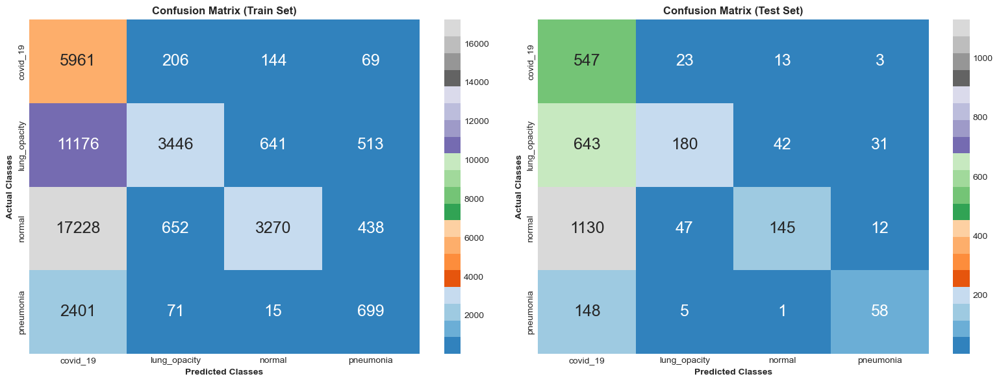

In [8]:
train_confmat = e_utils.get_confmat(train_set.targets, train_preds)
test_confmat = e_utils.get_confmat(test_set.targets, test_preds)
plot_confmat(train_confmat, test_confmat, train_set.classes, f'{type(inception_v3).__name__.lower()}')

In [9]:
results = e_utils.get_results(test_confmat, test_set.classes)
results

{'covid_19': [0.3217993079584775,
  0.22163695299837927,
  0.9334470989761092,
  0.35821872953503603],
 'lung_opacity': [0.5403834979662987,
  0.7058823529411765,
  0.20089285714285715,
  0.3127715030408341],
 'normal': [0.42758620689655175,
  0.7213930348258707,
  0.10869565217391304,
  0.18892508143322473],
 'pneumonia': [0.8230088495575221,
  0.5576923076923077,
  0.27358490566037735,
  0.3670886075949367]}

### SqueezeNet

In [6]:
squeezenet1_0 = e_networks.get_squeezenet1_0(out_features=4, path='models/lr3e-5_squeezenet_cuda.pth')
train_preds = e_utils.get_all_preds(squeezenet1_0, train_dl)
test_preds = e_utils.get_all_preds(squeezenet1_0, test_dl)

train_preds.shape, test_preds.shape

C:\Users\Abhijith\anaconda3\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\Abhijith\anaconda3\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


(torch.Size([46930, 1024]), torch.Size([3028, 1024]))

In [7]:
train_correct = e_utils.get_num_correct(train_preds, torch.as_tensor(train_set.targets, device=device))
test_correct = e_utils.get_num_correct(test_preds, torch.as_tensor(test_set.targets, device=device))

print(f'Train Correct: {train_correct:5}\tTrain Accuracy: {(100*train_correct/len(train_set)):5.2f}%')
print(f'Test Correct: {test_correct:6}\tTest Accuracy: {(100*test_correct/len(test_set)):6.2f}%')

Train Correct: 41100	Train Accuracy: 87.58%
Test Correct:   2469	Test Accuracy:  81.54%


In [10]:
train_confmat = e_utils.get_confmat(train_set.targets, train_preds)
test_confmat = e_utils.get_confmat(test_set.targets, test_preds)
plot_confmat(train_confmat, test_confmat, train_set.classes, f'{type(squeezenet1_0).__name__.lower()}')

tensor([[1, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0]], dtype=torch.int16)_0_0
tensor([[2, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0]], dtype=torch.int16)_0_0
tensor([[3, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0]], dtype=torch.int16)_0_0
tensor([[4, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0]], dtype=torch.int16)_0_0
tensor([[5, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0]], dtype=torch.int16)_0_0
tensor([[5, 0, 1, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0]], dtype=torch.int16)_0_2
tensor([[6, 0, 1, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0]], dtype=torch.int16)_0_0
tensor([[7, 0, 1, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0]], dtype=torch.int16)_0_0
tensor([[8, 0, 1, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0],
        [0, 0, 0, 0]], dtype=torch.int

tensor([[1221,   41,   24,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[1222,   41,   24,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[1223,   41,   24,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[1224,   41,   24,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[1225,   41,   24,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[1226,   41,   24,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[1227,   41,   24,    0],
      

tensor([[2322,   62,   62,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[2323,   62,   62,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[2324,   62,   62,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[2325,   62,   62,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[2326,   62,   62,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[2327,   62,   62,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[2328,   62,   62,    0],
      

tensor([[3452,   86,   78,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[3453,   86,   78,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[3454,   86,   78,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[3455,   86,   78,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[3456,   86,   78,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[3457,   86,   78,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[3458,   86,   78,    0],
      

tensor([[4645,  109,   90,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[4646,  109,   90,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[4647,  109,   90,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[4648,  109,   90,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[4649,  109,   90,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[4650,  109,   90,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[4651,  109,   90,    0],
      

tensor([[5828,  153,  106,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[5829,  153,  106,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[5830,  153,  106,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[5830,  154,  106,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_1
tensor([[5830,  155,  106,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_1
tensor([[5831,  155,  106,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_0_0
tensor([[5831,  156,  106,    0],
      

tensor([[6047,  222,  110,    1],
        [  24,  770,  134,    1],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [  24,  771,  134,    1],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [  24,  772,  134,    1],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [  24,  772,  135,    1],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_2
tensor([[6047,  222,  110,    1],
        [  24,  773,  135,    1],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [  24,  774,  135,    1],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
      

tensor([[6047,  222,  110,    1],
        [  48, 1789,  335,    1],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [  48, 1790,  335,    1],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [  48, 1791,  335,    1],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [  48, 1792,  335,    1],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [  48, 1793,  335,    1],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [  48, 1793,  336,    1],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_2
tensor([[6047,  222,  110,    1],
      

tensor([[6047,  222,  110,    1],
        [  75, 2775,  534,    1],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [  75, 2776,  534,    1],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [  75, 2776,  535,    1],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_2
tensor([[6047,  222,  110,    1],
        [  75, 2776,  536,    1],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_2
tensor([[6047,  222,  110,    1],
        [  75, 2777,  536,    1],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [  75, 2778,  536,    1],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
      

tensor([[6047,  222,  110,    1],
        [ 104, 3742,  746,    1],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_2
tensor([[6047,  222,  110,    1],
        [ 104, 3743,  746,    1],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [ 104, 3744,  746,    1],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [ 104, 3745,  746,    1],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [ 104, 3746,  746,    1],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [ 104, 3747,  746,    1],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
      

tensor([[6047,  222,  110,    1],
        [ 122, 4805,  941,    2],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [ 122, 4806,  941,    2],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [ 122, 4807,  941,    2],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [ 122, 4807,  942,    2],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_2
tensor([[6047,  222,  110,    1],
        [ 122, 4807,  943,    2],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_2
tensor([[6047,  222,  110,    1],
        [ 122, 4807,  944,    2],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_2
tensor([[6047,  222,  110,    1],
      

tensor([[6047,  222,  110,    1],
        [ 155, 5855, 1102,    2],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [ 155, 5856, 1102,    2],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [ 155, 5857, 1102,    2],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [ 155, 5858, 1102,    2],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [ 155, 5859, 1102,    2],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [ 155, 5860, 1102,    2],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
      

tensor([[6047,  222,  110,    1],
        [ 181, 6880, 1265,    3],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [ 181, 6881, 1265,    3],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [ 181, 6882, 1265,    3],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [ 181, 6883, 1265,    3],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [ 181, 6884, 1265,    3],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [ 181, 6885, 1265,    3],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
      

tensor([[6047,  222,  110,    1],
        [ 206, 7886, 1426,    3],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [ 206, 7887, 1426,    3],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [ 206, 7888, 1426,    3],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [ 206, 7889, 1426,    3],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [ 206, 7890, 1426,    3],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [ 206, 7891, 1426,    3],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
      

tensor([[6047,  222,  110,    1],
        [ 235, 8882, 1569,    3],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [ 235, 8883, 1569,    3],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [ 235, 8884, 1569,    3],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [ 235, 8885, 1569,    3],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [ 235, 8886, 1569,    3],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
        [ 235, 8887, 1569,    3],
        [   0,    0,    0,    0],
        [   0,    0,    0,    0]], dtype=torch.int16)_1_1
tensor([[6047,  222,  110,    1],
      

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   12,    58,  1028,    30],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   12,    58,  1029,    30],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   12,    58,  1030,    30],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   12,    58,  1031,    30],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   12,    58,  1032,    30],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   12,    58,  1033,    30],
      

tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   21,   139,  2231,    35],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_1
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   21,   139,  2232,    35],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   21,   139,  2233,    35],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   21,   139,  2234,    35],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   21,   139,  2235,    35],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   21,   139,  2236,    35],
      

tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   28,   218,  3365,    39],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   28,   218,  3366,    39],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   28,   218,  3367,    39],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   28,   218,  3368,    39],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   28,   218,  3369,    39],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   28,   218,  3370,    39],
      

tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   42,   352,  4427,    43],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   42,   352,  4428,    43],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   42,   352,  4429,    43],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   42,   353,  4429,    43],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_1
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   42,   353,  4430,    43],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   42,   353,  4431,    43],
      

tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   48,   415,  5548,    48],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   48,   416,  5548,    48],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_1
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   48,   416,  5549,    48],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   48,   417,  5549,    48],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_1
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   48,   417,  5550,    48],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   48,   417,  5551,    48],
      

tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   66,   485,  6669,    56],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   66,   485,  6670,    56],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   66,   485,  6671,    56],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   66,   485,  6672,    56],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   66,   485,  6673,    56],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   66,   485,  6674,    56],
      

tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   82,   588,  7771,    62],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   82,   588,  7772,    62],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   82,   588,  7773,    62],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   82,   588,  7774,    62],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   82,   588,  7775,    62],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   82,   588,  7776,    62],
      

tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   96,   676,  8824,    79],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_1
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   96,   676,  8825,    79],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   96,   676,  8826,    79],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   96,   676,  8827,    79],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   96,   676,  8828,    79],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [   96,   677,  8828,    79],
      

tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  117,   787,  9904,    87],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  117,   787,  9905,    87],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  117,   787,  9906,    87],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  117,   787,  9907,    87],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  117,   787,  9908,    87],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  117,   787,  9909,    87],
      

tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  128,   907, 10957,    95],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  128,   907, 10958,    95],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  128,   907, 10959,    95],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  128,   907, 10960,    95],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  128,   907, 10961,    95],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  128,   907, 10962,    95],
      

tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  151,  1006, 11996,   104],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  151,  1006, 11997,   104],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  151,  1006, 11998,   104],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  151,  1006, 11999,   104],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  151,  1006, 12000,   104],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  151,  1006, 12001,   104],
      

tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  166,  1119, 13094,   110],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  166,  1119, 13095,   110],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  166,  1119, 13096,   110],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  166,  1119, 13097,   110],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  166,  1119, 13098,   110],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  166,  1119, 13099,   110],
      

tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  187,  1235, 14161,   115],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  187,  1235, 14162,   115],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  187,  1235, 14163,   115],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  187,  1235, 14164,   115],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  187,  1235, 14165,   115],
        [    0,     0,     0,     0]], dtype=torch.int16)_2_2
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  187,  1235, 14166,   115],
      

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  371,  2665, 18284,   268],
        [    0,     0,     3,   170]], dtype=torch.int16)_3_3
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  371,  2665, 18284,   268],
        [    0,     0,     3,   171]], dtype=torch.int16)_3_3
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  371,  2665, 18284,   268],
        [    0,     0,     3,   172]], dtype=torch.int16)_3_3
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  371,  2665, 18284,   268],
        [    0,     0,     3,   173]], dtype=torch.int16)_3_3
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  371,  2665, 18284,   268],
        [    0,     0,     3,   174]], dtype=torch.int16)_3_3
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  371,  2665, 18284,   268],
      

tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  371,  2665, 18284,   268],
        [    0,     5,    12,  1449]], dtype=torch.int16)_3_3
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  371,  2665, 18284,   268],
        [    0,     5,    12,  1450]], dtype=torch.int16)_3_3
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  371,  2665, 18284,   268],
        [    0,     5,    12,  1451]], dtype=torch.int16)_3_3
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  371,  2665, 18284,   268],
        [    0,     5,    12,  1452]], dtype=torch.int16)_3_3
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  371,  2665, 18284,   268],
        [    0,     5,    12,  1453]], dtype=torch.int16)_3_3
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  371,  2665, 18284,   268],
      

tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  371,  2665, 18284,   268],
        [   13,     7,    20,  2629]], dtype=torch.int16)_3_3
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  371,  2665, 18284,   268],
        [   13,     7,    20,  2630]], dtype=torch.int16)_3_3
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  371,  2665, 18284,   268],
        [   13,     7,    20,  2631]], dtype=torch.int16)_3_3
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  371,  2665, 18284,   268],
        [   13,     7,    20,  2632]], dtype=torch.int16)_3_3
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  371,  2665, 18284,   268],
        [   13,     7,    20,  2633]], dtype=torch.int16)_3_3
tensor([[ 6047,   222,   110,     1],
        [  344, 13636,  1791,     5],
        [  371,  2665, 18284,   268],
      

IndexError: index 14 is out of bounds for dimension 1 with size 4

In [ ]:
results = e_utils.get_results(test_confmat, test_set.classes)
results

### EfficientNet-B0

In [14]:
efficientnet_b0 = e_networks.get_efficientnet_b0(out_features=4, path='models/lr3e-5_efficientnet_cuda.pth')
train_preds = e_utils.get_all_preds(efficientnet_b0, train_dl)
test_preds = e_utils.get_all_preds(efficientnet_b0, test_dl)

train_preds.shape, test_preds.shape

C:\Users\Abhijith\anaconda3\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\Abhijith\anaconda3\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


(torch.Size([46930, 1000]), torch.Size([3028, 1000]))

In [15]:
train_correct = e_utils.get_num_correct(train_preds, torch.as_tensor(train_set.targets, device=device))
test_correct = e_utils.get_num_correct(test_preds, torch.as_tensor(test_set.targets, device=device))

print(f'Train Correct: {train_correct:5}\tTrain Accuracy: {(100*train_correct/len(train_set)):5.2f}%')
print(f'Test Correct: {test_correct:6}\tTest Accuracy: {(100*test_correct/len(test_set)):6.2f}%')

Train Correct: 46611	Train Accuracy: 99.32%
Test Correct:   2943	Test Accuracy:  97.19%


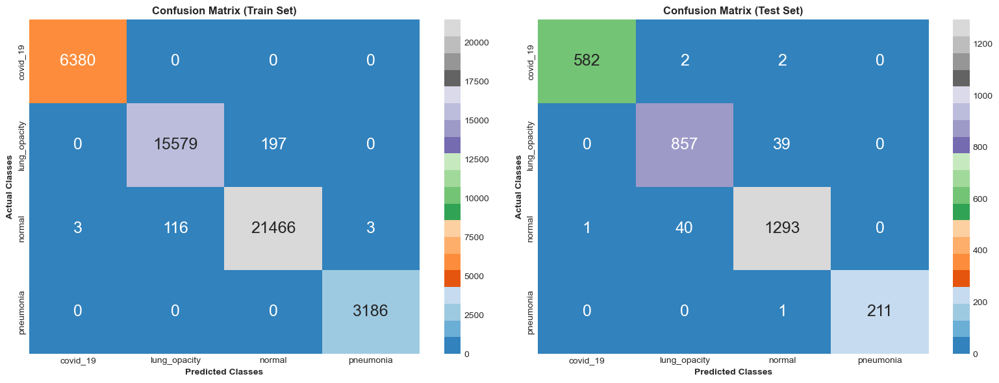

In [16]:
train_confmat = e_utils.get_confmat(train_set.targets, train_preds)
test_confmat = e_utils.get_confmat(test_set.targets, test_preds)
plot_confmat(train_confmat, test_confmat, train_set.classes, f'{type(efficientnet_b0).__name__.lower()}')

In [17]:
results = e_utils.get_results(test_confmat, test_set.classes)
results

{'covid_19': [0.998303934871099,
  0.9982847341337907,
  0.9931740614334471,
  0.9957228400342173],
 'lung_opacity': [0.9732142857142857,
  0.9532814238042269,
  0.9564732142857143,
  0.9548746518105848],
 'normal': [0.972571050892267,
  0.9685393258426966,
  0.9692653673163418,
  0.968902210565755],
 'pneumonia': [0.9996603260869565,
  1.0,
  0.9952830188679245,
  0.9976359338061466]}

### ResNet-18

In [10]:
resnet18 = e_networks.get_resnet18(out_features=4, path='models/lr3e-5_resnet_cuda.pth')
train_preds = e_utils.get_all_preds(resnet18, train_dl)
test_preds = e_utils.get_all_preds(resnet18, test_dl)

train_preds.shape, test_preds.shape

(torch.Size([46930, 4]), torch.Size([3028, 4]))

In [11]:
train_correct = e_utils.get_num_correct(train_preds, torch.as_tensor(train_set.targets, device=device))
test_correct = e_utils.get_num_correct(test_preds, torch.as_tensor(test_set.targets, device=device))

print(f'Train Correct: {train_correct:5}\tTrain Accuracy: {(100*train_correct/len(train_set)):5.2f}%')
print(f'Test Correct: {test_correct:6}\tTest Accuracy: {(100*test_correct/len(test_set)):6.2f}%')

Train Correct: 46426	Train Accuracy: 98.93%
Test Correct:   2937	Test Accuracy:  96.99%


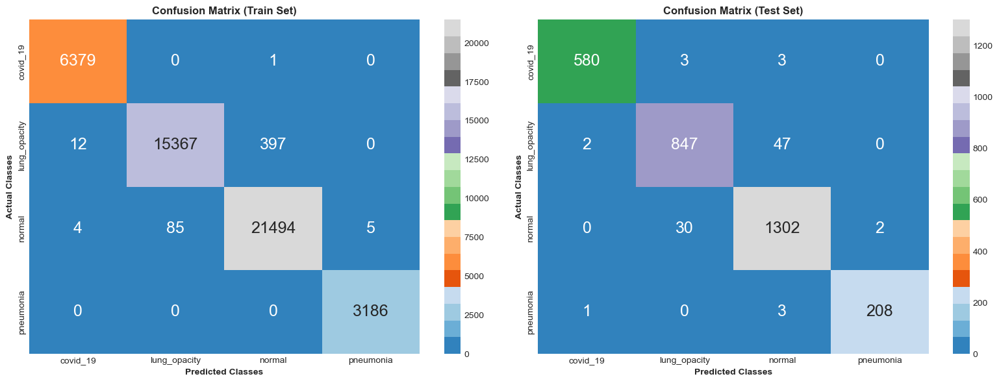

In [12]:
train_confmat = e_utils.get_confmat(train_set.targets, train_preds)
test_confmat = e_utils.get_confmat(test_set.targets, test_preds)
plot_confmat(train_confmat, test_confmat, train_set.classes, f'{type(resnet18).__name__.lower()}')

In [13]:
results = e_utils.get_results(test_confmat, test_set.classes)
results

{'covid_19': [0.9969450101832994,
  0.9948542024013722,
  0.9897610921501706,
  0.9923011120615911],
 'lung_opacity': [0.9728386883073865, 0.9625, 0.9453125, 0.9538288288288289],
 'normal': [0.971872931833223,
  0.9608856088560885,
  0.9760119940029985,
  0.9683897359613238],
 'pneumonia': [0.9979612640163099,
  0.9904761904761905,
  0.9811320754716981,
  0.9857819905213271]}

### DenseNet-121

In [15]:
densenet121 = networks.get_densenet121(out_features=4, path='/content/gdrive/MyDrive/xrays-and-gradcam-master/models/lr3e-5_densenet_cuda.pth')
train_preds = utils.get_all_preds(densenet121, train_dl)
test_preds = utils.get_all_preds(densenet121, test_dl)

train_preds.shape, test_preds.shape

/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


(torch.Size([20717, 4]), torch.Size([250, 4]))

In [16]:
train_correct = utils.get_num_correct(train_preds, torch.as_tensor(train_set.targets, device=device))
test_correct = utils.get_num_correct(test_preds, torch.as_tensor(test_set.targets, device=device))

print(f'Train Correct: {train_correct:5}\tTrain Accuracy: {(100*train_correct/len(train_set)):5.2f}%')
print(f'Test Correct: {test_correct:6}\tTest Accuracy: {(100*test_correct/len(test_set)):6.2f}%')

Train Correct: 19967	Train Accuracy: 96.38%
Test Correct:    236	Test Accuracy:  94.40%


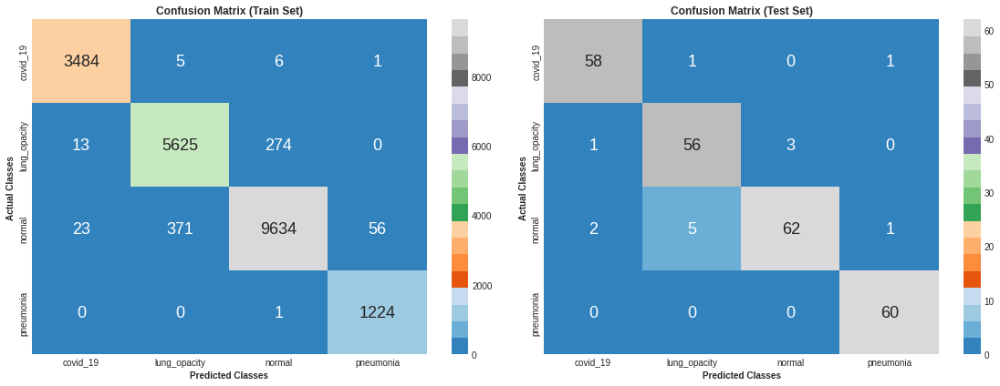

In [17]:
train_confmat = utils.get_confmat(train_set.targets, train_preds)
test_confmat = utils.get_confmat(test_set.targets, test_preds)
plot_confmat(train_confmat, test_confmat, train_set.classes, f'{type(densenet121).__name__.lower()}')

In [18]:
results = utils.get_results(test_confmat, test_set.classes)
results

{'covid_19': [0.979253112033195,
  0.9508196721311475,
  0.9666666666666667,
  0.9586776859504132],
 'lung_opacity': [0.959349593495935,
  0.9032258064516129,
  0.9333333333333333,
  0.9180327868852459],
 'normal': [0.9554655870445344,
  0.9538461538461539,
  0.8857142857142857,
  0.9185185185185185],
 'pneumonia': [0.9915966386554622, 0.967741935483871, 1.0, 0.9836065573770492]}

## Ensemble

In [6]:
ensemble = e_ensemble.EnsembleModel(torchvision.models.alexnet(pretrained=True),
                                    torchvision.models.resnet18(pretrained=True),
                                    torchvision.models.efficientnet_b0(pretrained=True))
for param in ensemble.parameters():
    param.requires_grad = False

for param in ensemble.classifier.parameters():
    param.requires_grad = True    

ensemble.load_state_dict(torch.load('models/lr3e-5_ensemblemodel_cuda.pth', map_location=device))
ensemble= ensemble.to(device)

train_preds = e_utils.get_all_preds(ensemble, train_dl)
test_preds = e_utils.get_all_preds(ensemble, test_dl)

train_preds.shape, test_preds.shape

C:\Users\Abhijith\anaconda3\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\Abhijith\anaconda3\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
C:\Users\Abhijith\anaconda3\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most

(torch.Size([46930, 4]), torch.Size([3028, 4]))

In [7]:
train_correct = e_utils.get_num_correct(train_preds, torch.as_tensor(train_set.targets, device=device))
test_correct = e_utils.get_num_correct(test_preds, torch.as_tensor(test_set.targets, device=device))

print(f'Train Correct: {train_correct:5}\tTrain Accuracy: {(100*train_correct/len(train_set)):5.2f}%')
print(f'Test Correct: {test_correct:6}\tTest Accuracy: {(100*test_correct/len(test_set)):6.2f}%')

Train Correct: 41867	Train Accuracy: 89.21%
Test Correct:   2645	Test Accuracy:  87.35%


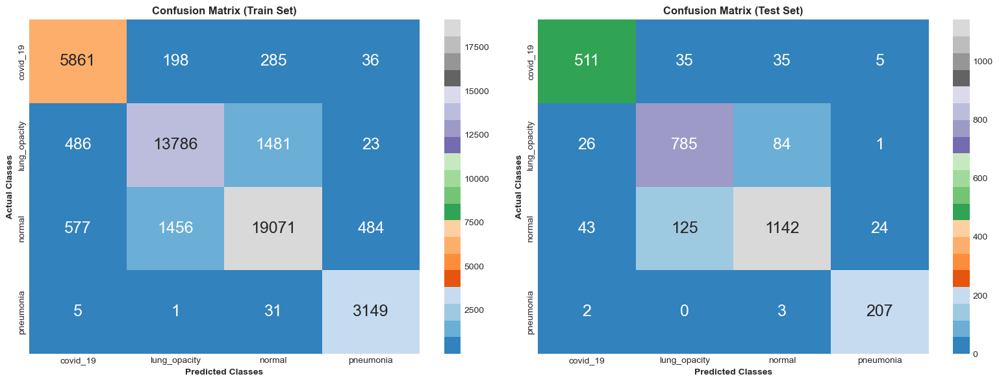

In [8]:
train_confmat = e_utils.get_confmat(train_set.targets, train_preds)
test_confmat = e_utils.get_confmat(test_set.targets, test_preds)
plot_confmat(train_confmat, test_confmat, train_set.classes, f'{type(ensemble).__name__.lower()}')

In [9]:
results = e_utils.get_results(test_confmat, test_set.classes)
results

{'covid_19': ['accuracy : 0.9476890003582945',
  'recall : 0.8780068728522337',
  'precision : 0.8720136518771331',
  'f1score : 0.875'],
 'lung_opacity': ['accuracy : 0.9070644718792867',
  'recall : 0.8306878306878307',
  'precision : 0.8761160714285714',
  'f1score : 0.8527973927213471'],
 'normal': ['accuracy : 0.8938830686042581',
  'recall : 0.9034810126582279',
  'precision : 0.856071964017991',
  'f1score : 0.8791377983063897'],
 'pneumonia': ['accuracy : 0.9869402985074627',
  'recall : 0.8734177215189873',
  'precision : 0.9764150943396226',
  'f1score : 0.9220489977728284']}

### GradCAM

/usr/local/lib/python3.8/dist-packages/torch/nn/modules/module.py:1117: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "


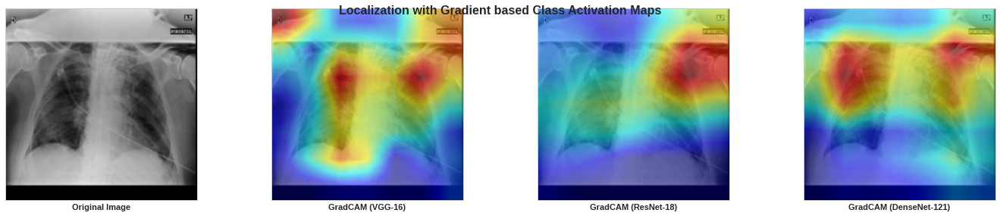

In [19]:
image, label = test_set[32]
image = image.unsqueeze(dim=0).to(device)

cam_obj = GradCAM(model=vgg16, target_layer=vgg16.features[-1])
_, vgg_cam = cam_obj(image, label)

cam_obj = GradCAM(model=resnet18, target_layer=resnet18.layer4[-1])
_, res_cam = cam_obj(image, label)

cam_obj = GradCAM(model=densenet121, target_layer=densenet121.features[-1])
_, dense_cam = cam_obj(image, label)

plot_gradcam(image, vgg_cam, res_cam, dense_cam)